# Model with respiration
---

To model ```respiration``` in the matrix model of Prochlorococcus, I had to make two major assumptions: 
- Carbon storage represents 30% of carbon fixed by photosynthesis (e.g., Zavreb et al. 2019)
- All carbon storage is consumed at night (ref TBD, but it has to be based on mass flux analysis)

These two assumptions would translate into a 30% reduction of carbon quotas from dusk to dawn (where dark respiration takes place).
A fun excercise. What is the expected reduction in cell diameter caused by respiration?

In [1]:
resp <- 30  # 30% change due to respiration
mass.at.dusk <- 50 # fg, Pro carbon quotas
mass.at.dawn <- mass.at.dusk * (100-resp)/100
volume.at.dusk <- (0.001*mass.at.dusk/(0.216))^{1/0.860} # Menden-Deuer & Lessard 2000
volume.at.dawn <- (0.001*mass.at.dawn/(0.216))^{1/0.860} 
diam.at.dusk <- 2 * round((3/4*volume.at.dusk /pi)^{1/3},2) 
diam.at.dawn <- 2 * round((3/4*volume.at.dawn /pi)^{1/3},2) 
diff <- diam.at.dusk - diam.at.dawn

print(paste0(resp,'% reduction in a ',mass.at.dusk,' fg Prochlorococcus would translate to : '))
print(paste0(round(100*(volume.at.dusk - volume.at.dawn)/volume.at.dusk),'% reduction in cell volume (',round(volume.at.dusk - volume.at.dawn,3),' cubic microns)'))
print(paste0(round(100*(diam.at.dusk - diam.at.dawn)/diam.at.dusk),'% reduction in cell diameter (',diam.at.dusk - diam.at.dawn,' microns)'))

[1] "30% reduction in a 50 fg Prochlorococcus would translate to : "
[1] "34% reduction in cell volume (0.062 cubic microns)"
[1] "11% reduction in cell diameter (0.08 microns)"


# Initialization
---
- example data (Ribalet et al. 2019, 3 days Prochlorococcus)

In [2]:
library(DEoptim)
library(cmaes) 
library(plotly)
library(tidyverse)

df <- read_csv("PRO_data/SeaFlow_SizeDist.csv") # load 4 days of observed Prochlorococcus size distribution (from Ribalet et al. 2019)

# Change temporal resolution from  3 minutes to 1 hour
dfh <- df %>%
        group_by(time = cut(time, breaks="1 hour")) %>%
        summarise_all(list(mean))
# time was converted to factor, and need to be convereted back to POSIXt
dfh$time <- as.POSIXct(dfh$time, tz='GMT')

# transform size class intervals to mean values (i.e. convert breaks (min, max] to mean). 
breaks <- strsplit(sub("\\]","",sub("\\(","",colnames(dfh)[-c(1,2)])),",")
midval <- unlist(list(lapply(breaks, function(x) mean(as.numeric(x)))))
colnames(dfh)[-c(1,2)] <- midval

Loading required package: parallel

DEoptim package
Differential Evolution algorithm in R
Authors: D. Ardia, K. Mullen, B. Peterson and J. Ulrich

Loading required package: ggplot2

Attaching package: 'plotly'

The following object is masked from 'package:ggplot2':

    last_plot

The following object is masked from 'package:stats':

    filter

The following object is masked from 'package:graphics':

    layout

-- Attaching packages --------------------------------------- tidyverse 1.2.1 --
v tibble  2.1.3     v purrr   0.3.3
v tidyr   1.0.0     v dplyr   0.8.3
v readr   1.3.1     v stringr 1.4.0
v tibble  2.1.3     v forcats 0.4.0
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks plotly::filter(), stats::filter()
x dplyr::lag()    masks stats::lag()
Parsed with column specification:
cols(
  .default = col_double(),
  time = col_datetime(format = "")
)
See spec(...) for full column specifications.


In [3]:
### plot 4 days size distribution
z <- as.matrix(dfh[,-c(1,2)])
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

In [3]:
### select 1 day Size distribution
id <- 17:41                             
distribution <- dfh[id,-c(2)]

### smooth the size distribution
# dist <- t(apply(distribution[,-c(1)],1, function(x) smooth.spline(x, all.knots=TRUE)$y))
# dist[which(dist < 0)] <- 0                              
# distribution[,-c(1)] <- dist
              
z <- as.matrix(distribution[,-c(1)])
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

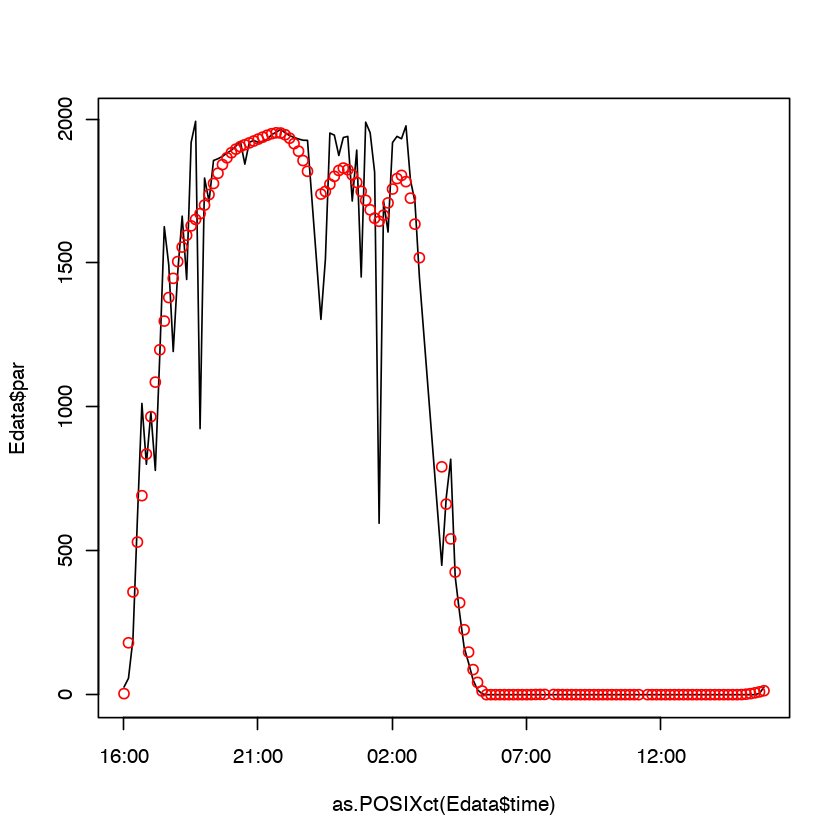

In [4]:
### smooth PAR data

# select PAR data covering the range of the size distribution
dfp <- subset(df, time  >= min(distribution$time) & time  < max(distribution$time))

# Change temporal resolution from  3 minutes to 10 minutes
Edata <- dfp[,c("time","par")] %>%
        group_by(time = cut(time, breaks="10 min")) %>%
        summarise_all(list(mean))

# smooth spline
ep <- smooth.spline(Edata, all.knots=TRUE)
Einterp <- ep$y
Einterp[Einterp < 0] <- 0

#plot
plot(as.POSIXct(Edata$time),Edata$par, type='l')
points(as.POSIXct(Edata$time),Einterp, col=2)

In [5]:
### set parameters for model
breaks <- strsplit(sub("\\]","",sub("\\(","",colnames(distribution)[-1])),",")
volbins <-  as.numeric(unlist(list(lapply(breaks, function(x) mean(as.numeric(x))))))                                   
resol <- 10
dt <- resol/60

- Load matrix model

In [6]:
#######################
## matrix.conct.fast ##
#######################
#Construct matrix A(t) for each time step within an hour based on delta and gamma at each 10 minute time intervals then construct B(t) which is A(t)'s multiplied for the given hour
#multiply B(t)*w(t) to get the projection to next hour dist if desired

.matrix.conct.fast <- function(hr, Einterp, volbins, gmax, dmax, b, E_star, resol){

		########################
		## INITIAL PARAMETERS ##
		########################
		t.nodiv <- 0 # no division during the first X hours after dawn
		dt <- resol/60
		j <- findInterval(2 * volbins[1], volbins)
		m <- length(volbins) # dimensions of the squared matrix

		####################
		## GAMMA FUNCTION ## fraction of cells that grow into next size class between t and t + dt
		####################
		# y <- (1-exp(-Einterp/E_star)) * gmax # original 2003 model
		y <- (gmax/E_star) * Einterp # NEW VERSION
		y[which(Einterp >= E_star)] <- gmax

		##########################
		## Respiration FUNCTION ## fraction of cells that shrink between t and t + dt
		##########################
				# Assumptions:
				# 1) rate of respiration is a function of photosynthetic rate (gamma function)
				# 2) rate of respiration constant (h-1) constant over the nighttime period (polysaccharide is drawn down linearly over the nighttime period)
        resp <-  mean(y[which(y > 0)]) * 0.3 - y # 30% carbon respired over a 24h-period, transformed to probability to shrink
		resp[which(resp < 0)] <- 0 # probablity to decrease size class is 0 when growth > respiration

		####################
		## DELTA FUNCTION ## fraction of cells that divide between t and t + dt
		####################
		# NOTE: most values of volbins need to be < 1 for compatibility issue with the Delta function # based on HYNES et al. 2015
		v <- volbins - volbins[j-1]
        del <- dmax * (v)^b / (1 + (v)^b)

		# del[1:(j-1)] <- 0
				if(hr < t.nodiv){delta <- matrix(data=0, 1, m)
					}else{delta <- matrix(del, 1, m)}
        # Top row; Small phytoplanktoin (i=1,..., j-1) are less than twice as big as the smallest size class, and so are prohibited to divide
        delta[1:(j-1)] <- 0
    

  
        ################################
		## CONSTRUCTION SPARSE MATRIX ##
		################################
    	stasis_ind <- seq(1,m^2,by=m+1) # Diagonal (0)stasis 
		growth_ind <- seq(2,m^2,by=m+1) # Subdiagonal (-1) growth 
		resp_ind <- seq((m+1)*2, m^2, by=m+1) # Superdiagonal (+1) respiration 
		div_ind <- seq((((j-1)*m)+1), m^2, by=m+1) # Superdiagonal (j-1) division

		for(t in 1:(1/dt)){
			#t <- 1
			A <- matrix(data=0,nrow=m, ncol=m)
			gamma <- y[t+hr/dt]
			respiration <- resp[t+hr/dt]*0 # no respiration

			# Stasis (main diagonal)
			A[stasis_ind] <- (1-delta)*(1-gamma)*(1-respiration) # the hr/dt part in the indexing is because each hour is broken up into dt segments for the irradiance spline
			A[m,m] <- (1-delta[m])*(1-respiration)

			# Cell growth (subdiagonal)
			A[growth_ind] <- gamma*(1-delta[1:(m-1)])

			# Division (first row and superdiagonal j-1)
			A[div_ind] <- 2 * delta[j:m] # The cell division terms for large (i > = j) phytoplankton

			# Respiration (superdiagonal)
			A[resp_ind] <- respiration*(1-delta[3:m])*(1-gamma)

					if(t == 1){B <- A}else{B <- A %*% B}
			}

		return(B)
}

# 1. Objective functions
---

- ### sum of squared residuals 
$$
Resid = \sum_{i=1}^{24} \sum_{i=1}^{n} (y - \hat{y})^2

In [7]:
############### 
## sigma.lsq ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# This function returns a column vector - called by "determine.opt.para" for the optimization.

	.sigma.lsq <- function(params, Einterp, distribution, resol){

				time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, dim[1], dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1]) 
                dmax <- as.numeric(params[2])
                b <- as.numeric(params[3]) * 10
                E_star <- as.numeric(params[4]) * 5000

			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% (PDF[,hr]/sum(PDF[,hr])) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
					sigma[,hr] <-  (PDF[,hr+1] - round(TotN[hr+1]*wt.norm))^2 # ABSOLUTE observed value - fitted value
					}
			sigma <- colSums(sigma)/colSums(PDF[,-1])
			sigma <- mean(sigma, na.rm=T)
			return(sigma)

}

In [8]:
start <- Sys.time()

f <- function(params) .sigma.lsq(params, Einterp, distribution, resol)

    opt <- DEoptim(f, lower=c(0,0,0,0), upper=c(1,1,1,1), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))
		params <- opt$optim$bestmem
        gmax <- as.numeric(params[1]) 
        dmax <- as.numeric(params[2])
        b <- as.numeric(params[3]) * 10
        E_star <- as.numeric(params[4]) * 5000
		resnorm <- opt$optim$bestval

Sys.time()-start

Iteration: 10 bestvalit: 41.272018 bestmemit:    0.224612    0.416072    0.105721    0.514179
Iteration: 20 bestvalit: 40.737321 bestmemit:    0.196747    0.050714    0.054612    0.450615
Iteration: 30 bestvalit: 40.669324 bestmemit:    0.116063    0.101582    0.074331    0.055073
Iteration: 40 bestvalit: 40.669324 bestmemit:    0.116063    0.101582    0.074331    0.055073
Iteration: 50 bestvalit: 40.574878 bestmemit:    0.150257    0.070122    0.062199    0.107880
Iteration: 60 bestvalit: 40.547829 bestmemit:    0.136230    0.050714    0.054612    0.127457
Iteration: 70 bestvalit: 40.515641 bestmemit:    0.131728    0.070122    0.062199    0.054488
Iteration: 80 bestvalit: 40.504286 bestmemit:    0.141241    0.071742    0.061727    0.083218
Iteration: 90 bestvalit: 40.502593 bestmemit:    0.136255    0.070122    0.062199    0.062571
Iteration: 100 bestvalit: 40.497905 bestmemit:    0.141296    0.056180    0.056341    0.084883
Iteration: 110 bestvalit: 40.489769 bestmemit:    0.136229 

Time difference of 3.532769 mins

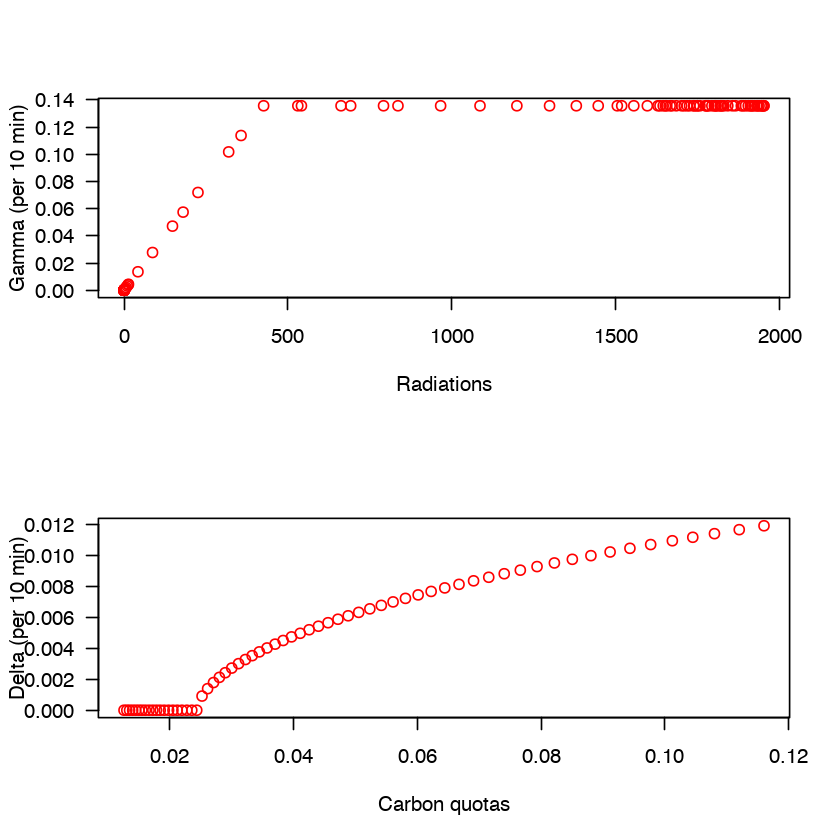

In [9]:
y <- (gmax/E_star) * Einterp 
y[which(Einterp >= E_star)] <- gmax	

j <- findInterval(2 * volbins[1], volbins)

v <- volbins - volbins[j-1]
    del <- dmax * (v)^b / (1 + (v)^b)
    delta <- matrix(del, 1, length(volbins))
	delta[1:(j-1)] <- 0

par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, delta, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)  

- ### Huber loss 
$$
L =\begin{cases}
\frac12(y - \hat{y})^2 & for |y - \hat{y}| \leq d\\
d|y - \hat{y}| - \frac12 d^2 & otherwise
\end{cases}
$$


In [10]:
###############
## sigma.hl ##
###############
# This function calculates the sum of squares of the of the differences between the hourly observations and the model given the specified parameters
# using Hubert Loss (1954) approach.

	.sigma.hl <- function(params, Einterp, distribution, resol){

			    time.interval <- median(diff(distribution$time))
				res <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
                PDF <- t(distribution[,-c(1)])
				dim <- dim(PDF)
				sigma <- matrix(NA, 1, dim[2]-1) # preallocate sigma
				TotN <- as.matrix(colSums(PDF))
                volbins <- as.numeric(rownames(PDF))
        
                gmax <- as.numeric(params[1]) 
                dmax <- as.numeric(params[2]) 
                b <- as.numeric(params[3]) * 10
                E_star <- as.numeric(params[4]) * 5000

        d <- 1.345
			for(hr in res){
					B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
					wt <- B %*% (PDF[,hr]/sum(PDF[,hr])) # calculate the projected size-frequency distribution
					wt.norm <- wt/sum(wt, na.rm=T) # normalize distribution
                  # Huber loss calculation
                    a <- (PDF[,hr+1] - round(TotN[hr+1]*wt.norm))/1000
                    loss <- ifelse(abs(a) <= d,
                                       0.5 * a^2,
                                       d * abs(a) - 0.5 * d^2)
                    sigma[,hr] <- mean(loss, na.rm=T)
                     }
            sigma <- sum(sigma, na.rm=T) ## HUBER loss

			return(sigma)

}

In [11]:
start <- Sys.time()

f <- function(params) .sigma.hl(params=params, Einterp=Einterp, distribution=distribution, resol=resol)

    opt <- DEoptim(f, lower=c(0,0,0,0), upper=c(1,1,1,1), control=DEoptim.control(itermax=1000, reltol=1e-3, trace=10, steptol=100, strategy=2, parallelType=0))
		params <- opt$optim$bestmem
        gmax.. <- as.numeric(params[1]) 
        dmax.. <- as.numeric(params[2]) 
        b.. <- as.numeric(params[3]) * 10
        E_star.. <- as.numeric(params[4]) * 5000
		resnorm.. <- opt$optim$bestval

Sys.time() - start

Iteration: 10 bestvalit: 1.108451 bestmemit:    0.302154    0.059328    0.059972    0.649811
Iteration: 20 bestvalit: 1.106371 bestmemit:    0.119028    0.098344    0.075205    0.032910
Iteration: 30 bestvalit: 1.106087 bestmemit:    0.124161    0.201092    0.087928    0.115743
Iteration: 40 bestvalit: 1.104124 bestmemit:    0.138343    0.146903    0.081256    0.141338
Iteration: 50 bestvalit: 1.099496 bestmemit:    0.138343    0.086401    0.067843    0.095632
Iteration: 60 bestvalit: 1.099496 bestmemit:    0.138343    0.086401    0.067843    0.095632
Iteration: 70 bestvalit: 1.099496 bestmemit:    0.138343    0.086401    0.067843    0.095632
Iteration: 80 bestvalit: 1.099166 bestmemit:    0.137050    0.088605    0.066719    0.085095
Iteration: 90 bestvalit: 1.098957 bestmemit:    0.137570    0.078837    0.064738    0.082959
Iteration: 100 bestvalit: 1.098879 bestmemit:    0.138778    0.082184    0.065367    0.083176
Iteration: 110 bestvalit: 1.098798 bestmemit:    0.139586    0.079737

Time difference of 3.578116 mins

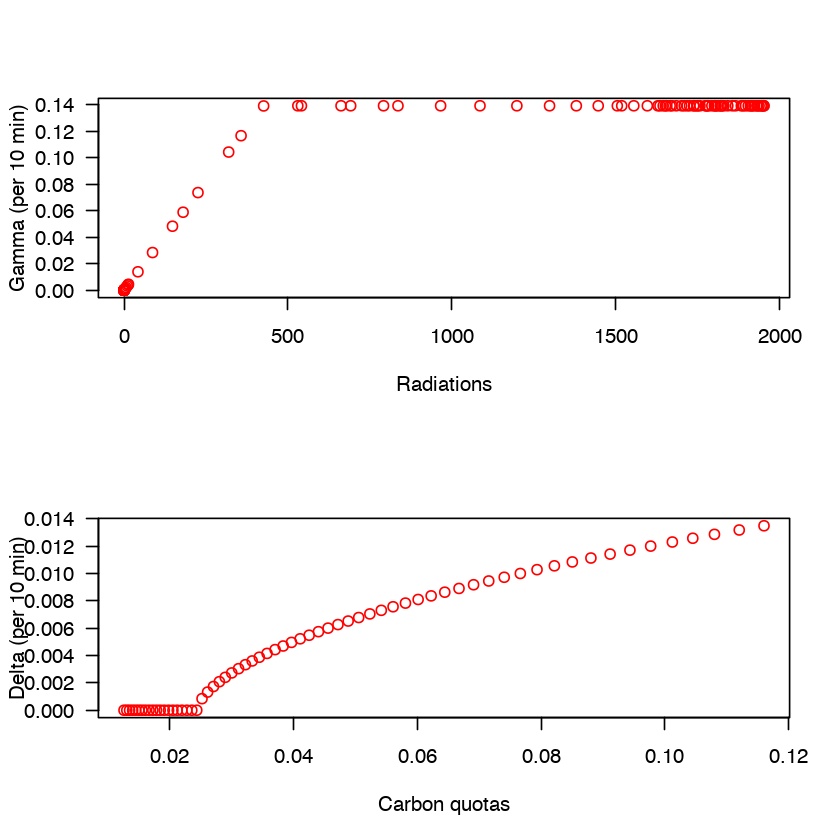

In [12]:
y <- (gmax../E_star..) * Einterp 
y[which(Einterp >= E_star..)] <- gmax..	

j <- findInterval(2 * volbins[1], volbins)

v <- volbins - volbins[j-1]
    del <- dmax.. * (v)^b.. / (1 + (v)^b..)
    delta <- matrix(del, 1, length(volbins))
	delta[1:(j-1)] <- 0

par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, delta, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)    

##  Results

In [13]:
library(ggplot2)
library(reshape2)
time.interval <- median(diff(distribution$time))
resolution <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
Nproj <-  Nproj.. <- t(distribution[,-c(1)]) 

for(hr in resolution){
 	B <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax, dmax=dmax, b=b, E_star=E_star, resol=resol)
     Nproj[,hr+1] <- round(B %*% Nproj[,hr]) # calculate numbers of individuals
            		    
    B.. <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax.., dmax=dmax..,b=b.., E_star=E_star.., resol=resol)
    Nproj..[,hr+1] <- round(B.. %*% Nproj..[,hr]) # calculate numbers of individuals
     		    
       }


#############################
## Growth rate calculation ##
#############################
 mu_N <- round(diff(log(colSums(Nproj[,-c(1,24)],na.rm=T))),3)/ as.numeric(diff(distribution$time)[-c(1,24)])
mu_N.. <- round(diff(log(colSums(Nproj..[,-c(1,24)],na.rm=T))),3)/ as.numeric(diff(distribution$time)[-c(1,24)])
 d.mu_N <- 24*mean(mu_N[-22], na.rm=T)
d.mu_N.. <- 24*mean(mu_N..[-22], na.rm=T)

print(paste("daily growth rate=",round(d.mu_N,2),"-",round(d.mu_N..,2)))


Attaching package: 'reshape2'

The following object is masked from 'package:tidyr':

    smiths



[1] "daily growth rate= 0.25 - 0.26"


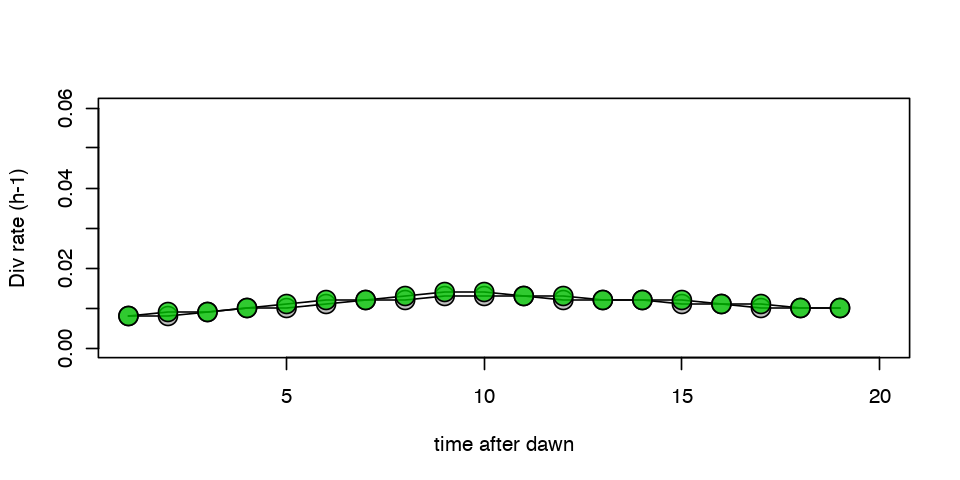

In [14]:
options(repr.plot.width=8, repr.plot.height=4)
plot(mu_N[-c(1:2)],type='o', ylim=c(0,0.06), xlab='time after dawn', ylab="Div rate (h-1)", pch=21, cex=2, bg=adjustcolor(1,0.25))
    points(mu_N..[-c(1:2)],type='o', pch=21, cex=2, bg=adjustcolor(3,0.75))

In [16]:
### plot size distribution
z <- as.matrix(Nproj)
plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

HTML widgets cannot be represented in plain text (need html)

# 2. Objective functions
---

- ### Covariance matrix adapting evolutionary strategy (cmaes package)

In [15]:
start_time <- Sys.time()

f <- function(params) .sigma.lsq(params=params, Einterp=Einterp, distribution=distribution, resol=resol)
    
opt2 <- cma_es(par=c(0.5,0.5,0.5,0.5),f, 
                  lower=c(0,0,0,0),   
                  upper=c(1,1,1,1), 
                  control=list(stopfitness= 1e-3, 
                               maxit=1000)
                 )

Sys.time() - start_time

 		params <- opt2$par
        gmax2 <- as.numeric(params[1]) 
        dmax2 <- as.numeric(params[2]) 
        b2 <- as.numeric(params[3]) * 10
        E_star2 <- as.numeric(params[4]) * 5000
		resnorm2 <- opt2$value
print(params)
print(resnorm2)

Time difference of 1.612404 mins

[1] 0.2483233 0.8192710 0.9152276 0.8680390
[1] 43.89357


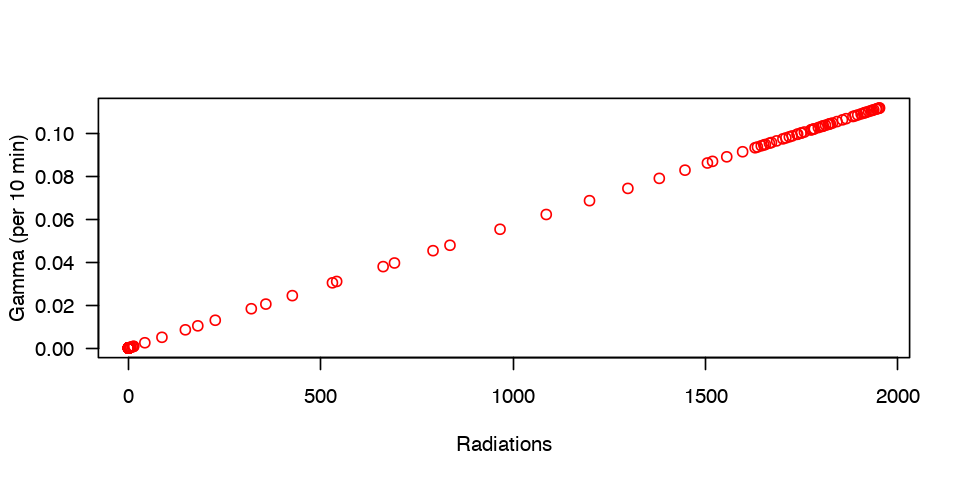

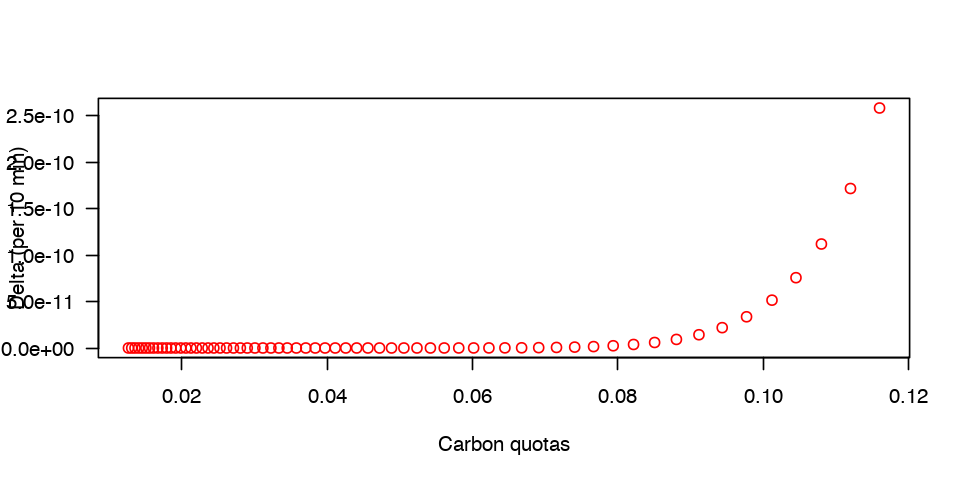

In [16]:
y <- (gmax2/E_star2) * Einterp 
y[which(Einterp >= E_star2)] <- gmax2	

j <- findInterval(2 * volbins[1], volbins)

v <- volbins - volbins[j-1]
    del <- dmax2 * (v)^b2 / (1 + (v)^b2)
    delta <- matrix(del, 1, length(volbins))
	delta[1:(j-1)] <- 0

# par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, delta, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)  

In [17]:
start_time <- Sys.time()

f <- function(params) .sigma.hl(params=params, Einterp=Einterp, distribution=distribution, resol=resol)
    
    opt2.. <- cma_es(par=c(0.5,0.5,0.5,0.5),f, 
                  lower=c(0,0,0,0),   
                  upper=c(1,1,1,1), 
                  control=list(stopfitness= 1e-6, 
                               maxit=1000)
                 )

Sys.time() - start_time

params <- opt2..$par
        gmax2.. <- as.numeric(params[1]) 
        dmax2.. <- as.numeric(params[2]) 
        b2.. <- as.numeric(params[3]) * 10
        E_star2.. <- as.numeric(params[4]) * 5000
		resnorm2.. <- opt2..$value
print(params)
print(resnorm2..)

Time difference of 0.3795319 secs

[1] 0.3177450 0.4758620 0.4968112 0.9031091
[1] 1.204483


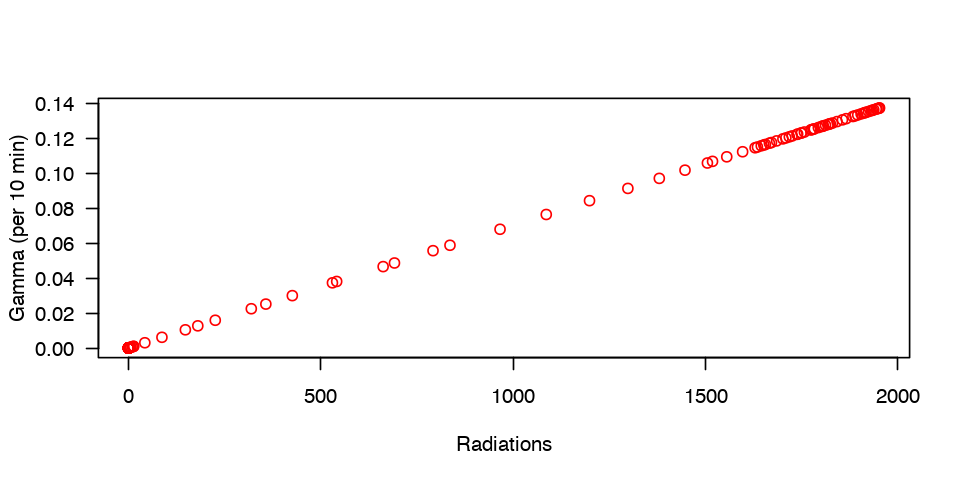

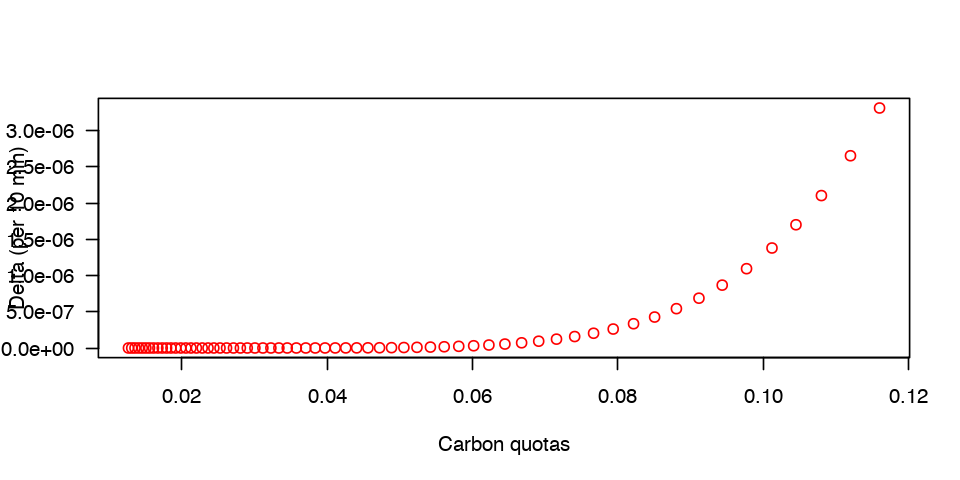

In [18]:
y <- (gmax2../E_star2..) * Einterp 
y[which(Einterp >= E_star2..)] <- gmax2..	

j <- findInterval(2 * volbins[1], volbins)

v <- volbins - volbins[j-1]
    del <- dmax2.. * (v)^b2.. / (1 + (v)^b2..)
    delta <- matrix(del, 1, length(volbins))
	delta[1:(j-1)] <- 0

#par(mfrow=c(2,1))
plot(Einterp, y, type='p', col='red', xlab="Radiations", ylab=paste("Gamma (per",60*dt,"min)"), las=1)
plot(volbins, delta, type='p', col='red', xlab="Carbon quotas", ylab=paste("Delta (per",60*dt,"min)"), las=1)  

##  Results

In [19]:
library(ggplot2)
library(reshape2)
time.interval <- median(diff(distribution$time))
resolution <- which(diff(distribution$time) == time.interval)# select time that have at least 2 consecutive time points, required for comparing the projection to the next time point
Nproj2 <-  Nproj2.. <- t(distribution[,-c(1)]) 

for(hr in resolution){
	B2 <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax2, dmax=dmax2, b=b2, E_star=E_star2, resol=resol)
    Nproj2[,hr+1] <- round(B2 %*% Nproj2[,hr]) # calculate numbers of individuals
            		    
    B2.. <- .matrix.conct.fast(hr=hr-1, Einterp=Einterp, volbins=volbins, gmax=gmax2.., dmax=dmax2..,b=b2.., E_star=E_star2.., resol=resol)
    Nproj2..[,hr+1] <- round(B2.. %*% Nproj2..[,hr]) # calculate numbers of individuals
     		    
       }


#############################
## Growth rate calculation ##
#############################
mu_N2 <- round(diff(log(colSums(Nproj2[,-c(1,24)],na.rm=T))),3)/ as.numeric(diff(distribution$time)[-c(1,24)])
mu_N2.. <- round(diff(log(colSums(Nproj2..[,-c(1,24)],na.rm=T))),3)/ as.numeric(diff(distribution$time)[-c(1,24)])
d.mu_N2 <- 24*mean(mu_N2[-c(22)], na.rm=T)
d.mu_N2.. <- 24*mean(mu_N2..[-c(22)], na.rm=T)

print(paste("daily growth rate=",round(d.mu_N2,2),"-",round(d.mu_N2..,2)))

[1] "daily growth rate= 0 - 0"


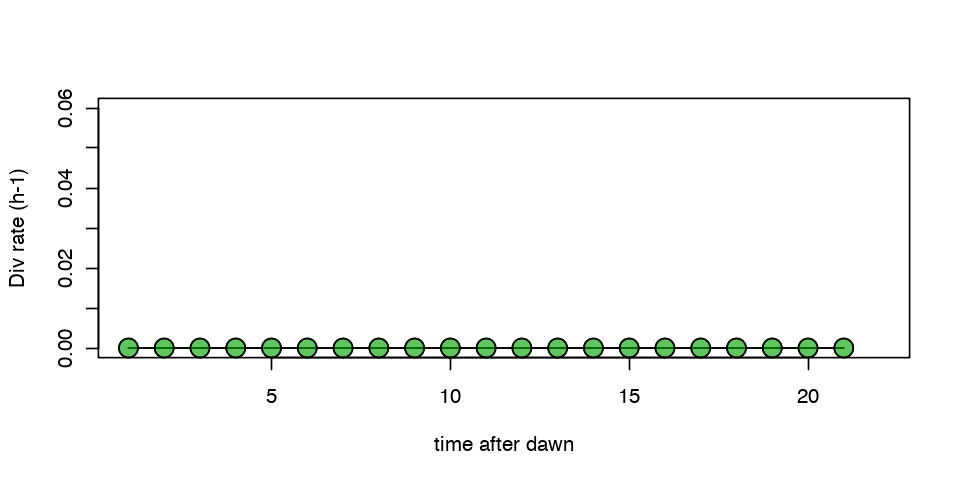

In [22]:
options(repr.plot.width=8, repr.plot.height=4)
plot(mu_N2,type='o', ylim=c(0,0.06), xlab='time after dawn', ylab="Div rate (h-1)", pch=21, cex=2, bg=adjustcolor(1,0.25))
    points(mu_N2..,type='o', pch=21, cex=2, bg=adjustcolor(3,0.5))


In [23]:
### plot size distribution
ma2 <- round(apply(t(Nproj2), 1, function(x) max(x,na.rm=T)))
z <- as.matrix(t(Nproj2)/ma2)

plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

Warning message in max(x, na.rm = T):
"no non-missing arguments to max; returning -Inf"Warning message in max(x, na.rm = T):
"no non-missing arguments to max; returning -Inf"

HTML widgets cannot be represented in plain text (need html)

# plot Observed - Projected
---

In [24]:
### plot difference Observed - Projected
ma <- round(apply(distribution[,-c(1)], 1, function(x) max(x,na.rm=T)))

ma2 <- round(apply(t(Nproj2), 1, function(x) max(x,na.rm=T)))
                   
z <- as.matrix(distribution[,-c(1)]/ma) - as.matrix(t(Nproj2)/ma2)

plot_ly(z= z) %>% 
         add_surface() %>%
         layout(scene = list(xaxis = list(autorange = "reversed")))

Warning message in max(x, na.rm = T):
"no non-missing arguments to max; returning -Inf"Warning message in max(x, na.rm = T):
"no non-missing arguments to max; returning -Inf"

HTML widgets cannot be represented in plain text (need html)